In [1]:
import os
import time
import tensorflow as tf
import numpy as np
from glob import glob
import datetime
import random
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
def generator(z, output_channel_dim, training):
    with tf.variable_scope("generator", reuse= not training):
        
        # 8x8x1024
        fully_connected = tf.layers.dense(z, 8*8*1024)
        fully_connected = tf.reshape(fully_connected, (-1, 8, 8, 1024))
        fully_connected = tf.nn.leaky_relu(fully_connected)

        # 8x8x1024 -> 16x16x512
        trans_conv1 = tf.layers.conv2d_transpose(inputs=fully_connected,
                                                 filters=512,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv1")
        batch_trans_conv1 = tf.layers.batch_normalization(inputs = trans_conv1,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv1")
        trans_conv1_out = tf.nn.leaky_relu(batch_trans_conv1,
                                           name="trans_conv1_out")
        
        # 16x16x512 -> 32x32x256
        trans_conv2 = tf.layers.conv2d_transpose(inputs=trans_conv1_out,
                                                 filters=256,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv2")
        batch_trans_conv2 = tf.layers.batch_normalization(inputs = trans_conv2,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv2")
        trans_conv2_out = tf.nn.leaky_relu(batch_trans_conv2,
                                           name="trans_conv2_out")
        
        # 32x32x256 -> 64x64x128
        trans_conv3 = tf.layers.conv2d_transpose(inputs=trans_conv2_out,
                                                 filters=128,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv3")
        batch_trans_conv3 = tf.layers.batch_normalization(inputs = trans_conv3,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv3")
        trans_conv3_out = tf.nn.leaky_relu(batch_trans_conv3,
                                           name="trans_conv3_out")
        
        # 64x64x128 -> 128x128x64
        trans_conv4 = tf.layers.conv2d_transpose(inputs=trans_conv3_out,
                                                 filters=64,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv4")
        batch_trans_conv4 = tf.layers.batch_normalization(inputs = trans_conv4,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv4")
        trans_conv4_out = tf.nn.leaky_relu(batch_trans_conv4,
                                           name="trans_conv4_out")
        
        # 128x128x64 -> 128x128x3
        logits = tf.layers.conv2d_transpose(inputs=trans_conv4_out,
                                            filters=3,
                                            kernel_size=[5,5],
                                            strides=[1,1],
                                            padding="SAME",
                                            kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                            name="logits")
        out = tf.tanh(logits, name="out")
        return out

In [3]:
def discriminator(x, reuse):
    with tf.variable_scope("discriminator", reuse=reuse): 
        
        # 128*128*3 -> 64x64x64 
        conv1 = tf.layers.conv2d(inputs=x,
                                 filters=64,
                                 kernel_size=[5,5],
                                 strides=[2,2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv1')
        batch_norm1 = tf.layers.batch_normalization(conv1,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm1')
        conv1_out = tf.nn.leaky_relu(batch_norm1,
                                     name="conv1_out")
        
        # 64x64x64-> 32x32x128 
        conv2 = tf.layers.conv2d(inputs=conv1_out,
                                 filters=128,
                                 kernel_size=[5, 5],
                                 strides=[2, 2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv2')
        batch_norm2 = tf.layers.batch_normalization(conv2,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm2')
        conv2_out = tf.nn.leaky_relu(batch_norm2,
                                     name="conv2_out")
        
        # 32x32x128 -> 16x16x256  
        conv3 = tf.layers.conv2d(inputs=conv2_out,
                                 filters=256,
                                 kernel_size=[5, 5],
                                 strides=[2, 2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv3')
        batch_norm3 = tf.layers.batch_normalization(conv3,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm3')
        conv3_out = tf.nn.leaky_relu(batch_norm3,
                                     name="conv3_out")
        
        # 16x16x256 -> 16x16x512
        conv4 = tf.layers.conv2d(inputs=conv3_out,
                                 filters=512,
                                 kernel_size=[5, 5],
                                 strides=[1, 1],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv4')
        batch_norm4 = tf.layers.batch_normalization(conv4,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm4')
        conv4_out = tf.nn.leaky_relu(batch_norm4,
                                     name="conv4_out")
        
        # 16x16x512 -> 8x8x1024
        conv5 = tf.layers.conv2d(inputs=conv4_out,
                                filters=1024,
                                kernel_size=[5, 5],
                                strides=[2, 2],
                                padding="SAME",
                                kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                name='conv5')
        batch_norm5 = tf.layers.batch_normalization(conv5,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm5')
        conv5_out = tf.nn.leaky_relu(batch_norm5,
                                     name="conv5_out")

        flatten = tf.reshape(conv5_out, (-1, 8*8*1024))
        logits = tf.layers.dense(inputs=flatten,
                                 units=1,
                                 activation=None)
        out = tf.sigmoid(logits)
        return out, logits

In [4]:
def model_loss(input_real, input_z, output_channel_dim):
    g_model = generator(input_z, output_channel_dim, True)

    noisy_input_real = input_real + tf.random_normal(shape=tf.shape(input_real),
                                                     mean=0.0,
                                                     stddev=random.uniform(0.0, 0.1),
                                                     dtype=tf.float32)
    
    d_model_real, d_logits_real = discriminator(noisy_input_real, reuse=False)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,
                                                                         labels=tf.ones_like(d_model_real)*random.uniform(0.9, 1.0)))
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                         labels=tf.zeros_like(d_model_fake)))
    d_loss = tf.reduce_mean(0.5 * (d_loss_real + d_loss_fake))
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                    labels=tf.ones_like(d_model_fake)))
    return d_loss, g_loss

In [5]:
def model_optimizers(d_loss, g_loss):
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith("generator")]
    d_vars = [var for var in t_vars if var.name.startswith("discriminator")]
    
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    gen_updates = [op for op in update_ops if op.name.startswith('generator') or op.name.startswith('discriminator')]
    
    with tf.control_dependencies(gen_updates):
        d_train_opt = tf.train.AdamOptimizer(learning_rate=LR_D, beta1=BETA1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate=LR_G, beta1=BETA1).minimize(g_loss, var_list=g_vars)  
    return d_train_opt, g_train_opt

In [6]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='inputs_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name="input_z")
    learning_rate_G = tf.placeholder(tf.float32, name="lr_g")
    learning_rate_D = tf.placeholder(tf.float32, name="lr_d")
    return inputs_real, inputs_z, learning_rate_G, learning_rate_D

In [7]:
def show_samples(sample_images, name, epoch):
    figure, axes = plt.subplots(1, len(sample_images), figsize = (IMAGE_SIZE, IMAGE_SIZE))
    for index, axis in enumerate(axes):
        axis.axis('off')
        image_array = sample_images[index]
        axis.imshow(image_array)
        image = Image.fromarray(image_array)
        image.save(name+"_"+str(epoch)+"_"+str(index)+".png") 
    plt.savefig(name+"_"+str(epoch)+".png", bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()

In [8]:
def test(sess, input_z, out_channel_dim, epoch):
    example_z = np.random.uniform(-1, 1, size=[SAMPLES_TO_SHOW, input_z.get_shape().as_list()[-1]])
    samples = sess.run(generator(input_z, out_channel_dim, False), feed_dict={input_z: example_z})
    sample_images = [((sample + 1.0) * 127.5).astype(np.uint8) for sample in samples]
    show_samples(sample_images, OUTPUT_DIR + "samples", epoch)

In [9]:
def summarize_epoch(epoch, sess, d_losses, g_losses, input_z, data_shape, saver):
    print("\nEpoch {}/{}".format(epoch, EPOCHS),
          "\nD Loss: {:.5f}".format(np.mean(d_losses[-MINIBATCH_SIZE:])),
          "\nG Loss: {:.5f}".format(np.mean(g_losses[-MINIBATCH_SIZE:])))
    fig, ax = plt.subplots()
    plt.plot(d_losses, label='Discriminator', alpha=0.6)
    plt.plot(g_losses, label='Generator', alpha=0.6)
    plt.title("Losses")
    plt.legend()
    plt.savefig(OUTPUT_DIR + "losses_" + str(epoch) + ".png")
    plt.show()
    plt.close()
    saver.save(sess, OUTPUT_DIR + "model_" + str(epoch) + ".ckpt")
    test(sess, input_z, data_shape[3], epoch)

In [10]:
def get_batch(dataset):
    files = random.sample(dataset, BATCH_SIZE)
    batch = []
    for file in files:
        if random.choice([True, False]):
            batch.append(np.asarray(Image.open(file).transpose(Image.FLIP_LEFT_RIGHT)))
        else:
            batch.append(np.asarray(Image.open(file)))                     
    batch = np.asarray(batch)
    normalized_batch = (batch / 127.5) - 1.0
    return normalized_batch, files

In [11]:
def train(data_shape, epoch, checkpoint_path):
    input_images, input_z, lr_G, lr_D = model_inputs(data_shape[1:], NOISE_SIZE)
    d_loss, g_loss = model_loss(input_images, input_z, data_shape[3])
    d_opt, g_opt = model_optimizers(d_loss, g_loss)
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        saver = tf.train.Saver()
        if checkpoint_path is not None:
            saver.restore(sess, checkpoint_path)
            
        iteration = 0
        d_losses = []
        g_losses = []
        
        for epoch in range(EPOCH, EPOCHS):        
            epoch += 1
            epoch_dataset = DATASET.copy()
            
            for i in range(MINIBATCH_SIZE):
                iteration_start_time = time.time()
                iteration += 1
                batch_images, used_files = get_batch(epoch_dataset)
                [epoch_dataset.remove(file) for file in used_files]
                
                batch_z = np.random.uniform(-1, 1, size=(BATCH_SIZE, NOISE_SIZE))
                _ = sess.run(d_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr_D: LR_D})
                _ = sess.run(g_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr_G: LR_G})
                d_losses.append(d_loss.eval({input_z: batch_z, input_images: batch_images}))
                g_losses.append(g_loss.eval({input_z: batch_z}))
                
                elapsed_time = round(time.time()-iteration_start_time, 3)
                remaining_files = len(epoch_dataset)
                print("\rEpoch: " + str(epoch) +
                      ", iteration: " + str(iteration) + 
                      ", d_loss: " + str(round(d_losses[-1], 3)) +
                      ", g_loss: " + str(round(g_losses[-1], 3)) +
                      ", duration: " + str(elapsed_time) + 
                      ", minutes remaining: " + str(round(remaining_files/BATCH_SIZE*elapsed_time/60, 1)) +
                      ", remaining files in batch: " + str(remaining_files)
                      , sep=' ', end=' ', flush=True)
                
            summarize_epoch(epoch, sess, d_losses, g_losses, input_z, data_shape, saver)

In [12]:
# Hyperparameters
IMAGE_SIZE = 128
NOISE_SIZE = 100
LR_D = 0.00004
LR_G = 0.0002
BATCH_SIZE = 64
EPOCH = 0 # Non-zero only if we are resuming training with model checkpoint
EPOCHS = 5 #EPOCH + number of epochs to perform
BETA1 = 0.5
WEIGHT_INIT_STDDEV = 0.02
EPSILON = 0.00005
SAMPLES_TO_SHOW = 5

In [13]:
# Data (https://www.kaggle.com/greg115/celebrities-100k)
BASE_PATH = "./input/"
DATASET_LIST_PATH = BASE_PATH + "100k.txt"
INPUT_DATA_DIR = BASE_PATH + "100k/"
OUTPUT_DIR = "./"
DATASET = [INPUT_DATA_DIR + str(line).rstrip() for line in open(DATASET_LIST_PATH,"r")]
DATASET_SIZE = len(DATASET) 
MINIBATCH_SIZE = DATASET_SIZE // BATCH_SIZE

# Optional - model path to resume training
#MODEL_PATH = BASE_PATH + "models/" + "model_" + str(EPOCH) + ".ckpt"

In [15]:
def restart_training(epoch):
    EPOCH=epoch
    checkpoint_path=f'/opt/notebooks/model_{epoch}.ckpt'
    # Training
    with tf.Graph().as_default():
        train(data_shape=(DATASET_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3),
              epoch=EPOCH,
              checkpoint_path=checkpoint_path)

Instructions for updating:
Use keras.layers.Dense instead.
Instructions for updating:
Please use `layer.__call__` method instead.
Instructions for updating:
Use `tf.keras.layers.Conv2DTranspose` instead.
Instructions for updating:
Use keras.layers.BatchNormalization instead.  In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.batch_normalization` documentation).
Instructions for updating:
Use `tf.keras.layers.Conv2D` instead.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Epoch: 1, iteration: 1562, d_loss: 0.729, g_loss: 0.694, duration: 1.457, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 1/5 
D Loss: 0.96424 
G Loss: 0.63352


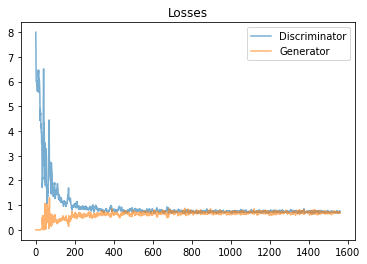

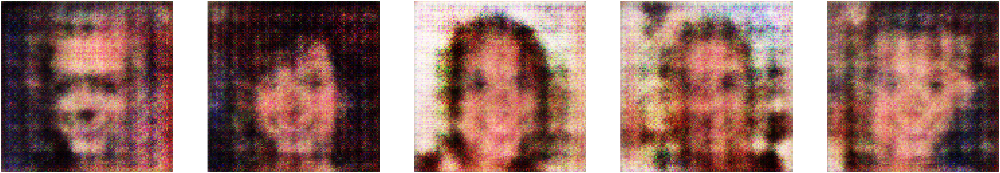

Epoch: 2, iteration: 3124, d_loss: 0.678, g_loss: 0.697, duration: 1.446, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 2/5 
D Loss: 0.72143 
G Loss: 0.70731


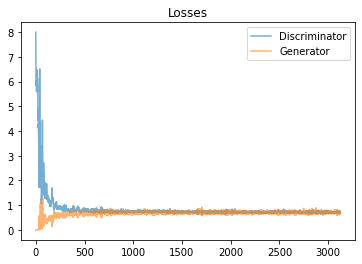

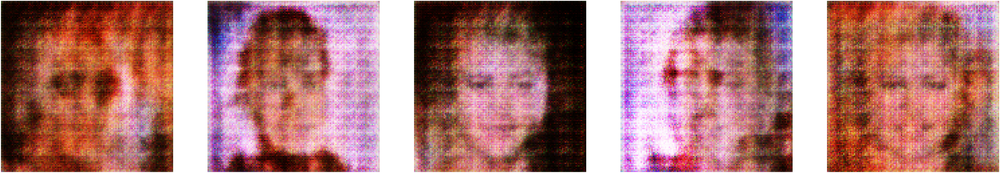

Epoch: 3, iteration: 3157, d_loss: 0.72, g_loss: 0.686, duration: 1.449, minutes remaining: 36.9, remaining files in batch: 97888  

KeyboardInterrupt: 

In [17]:
# Training
with tf.Graph().as_default():
    train(data_shape=(DATASET_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3),
          epoch=EPOCH,
          checkpoint_path=None)

In [22]:
!ls

FaceGeneratorDCGAN.ipynb	  samples_1.png
assets				  samples_1_0.png
bak				  samples_1_1.png
checkpoint			  samples_1_2.png
input				  samples_1_3.png
losses_1.png			  samples_1_4.png
losses_2.png			  samples_2.png
model_1.ckpt.data-00000-of-00001  samples_2_0.png
model_1.ckpt.index		  samples_2_1.png
model_1.ckpt.meta		  samples_2_2.png
model_2.ckpt.data-00000-of-00001  samples_2_3.png
model_2.ckpt.index		  samples_2_4.png
model_2.ckpt.meta


INFO:tensorflow:Restoring parameters from /opt/notebooks/model_2.ckpt
Epoch: 3, iteration: 1562, d_loss: 0.749, g_loss: 0.697, duration: 1.501, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 3/5 
D Loss: 0.71434 
G Loss: 0.73563


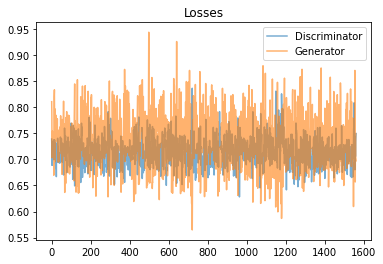

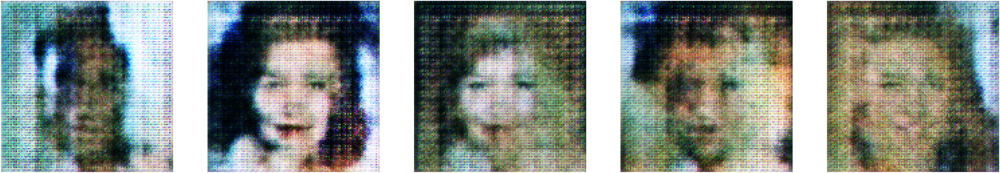

Epoch: 4, iteration: 3124, d_loss: 0.728, g_loss: 0.771, duration: 1.519, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 4/5 
D Loss: 0.71219 
G Loss: 0.73371


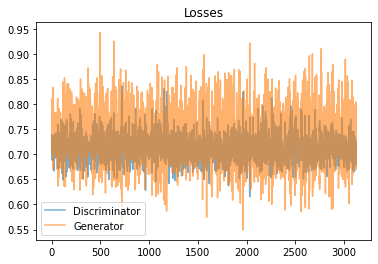

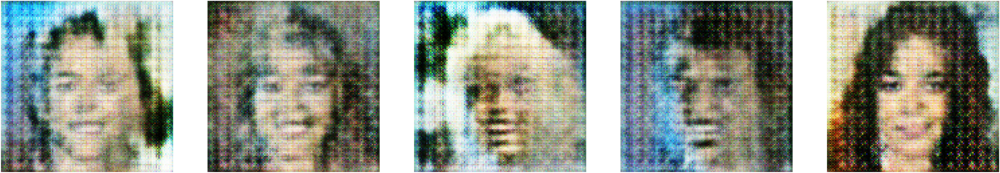

Epoch: 5, iteration: 3141, d_loss: 0.707, g_loss: 0.717, duration: 1.513, minutes remaining: 39.0, remaining files in batch: 98912 

KeyboardInterrupt: 

In [23]:
EPOCH=2
checkpoint_path='/opt/notebooks/model_2.ckpt'
# Training
with tf.Graph().as_default():
    train(data_shape=(DATASET_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3),
          epoch=EPOCH,
          checkpoint_path=checkpoint_path)

INFO:tensorflow:Restoring parameters from /opt/notebooks/model_4.ckpt
Epoch: 5, iteration: 1562, d_loss: 0.695, g_loss: 0.759, duration: 1.403, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 5/5 
D Loss: 0.70784 
G Loss: 0.74311


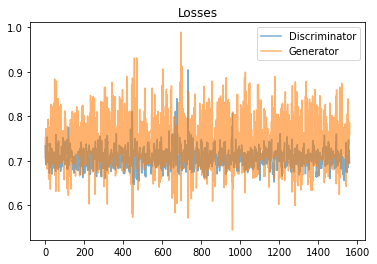

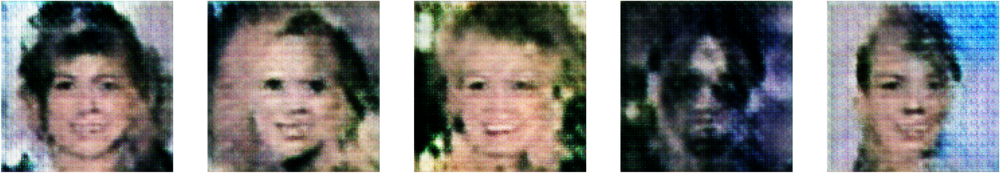

In [26]:
EPOCH=4
restart_training(EPOCH)

INFO:tensorflow:Restoring parameters from /opt/notebooks/model_5.ckpt
Epoch: 6, iteration: 1562, d_loss: 0.692, g_loss: 0.646, duration: 1.502, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 6/60 
D Loss: 0.70788 
G Loss: 0.70162


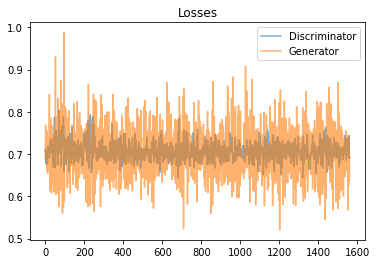

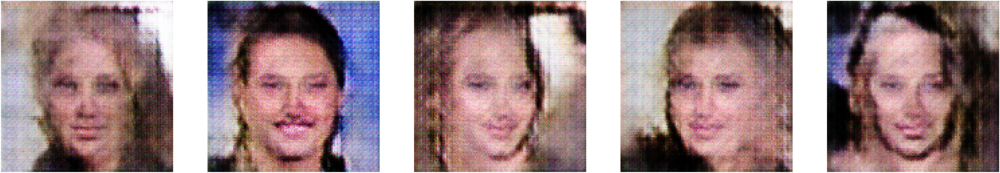

Epoch: 7, iteration: 3124, d_loss: 0.696, g_loss: 0.767, duration: 1.414, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 7/60 
D Loss: 0.70619 
G Loss: 0.69854


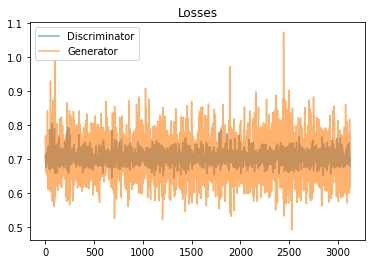

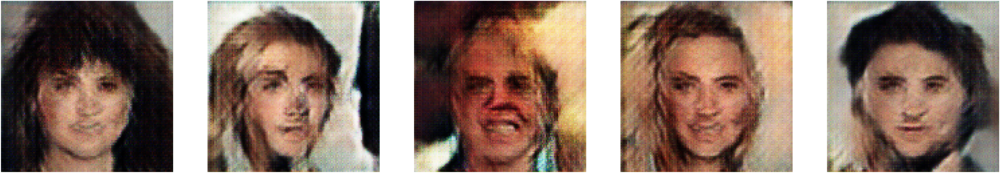

Epoch: 8, iteration: 3152, d_loss: 0.728, g_loss: 0.711, duration: 1.469, minutes remaining: 37.6, remaining files in batch: 98208 

KeyboardInterrupt: 

In [27]:
EPOCH=5
EPOCHS=60
restart_training(EPOCH)

Instructions for updating:
Use keras.layers.Dense instead.
Instructions for updating:
Please use `layer.__call__` method instead.
Instructions for updating:
Use `tf.keras.layers.Conv2DTranspose` instead.
Instructions for updating:
Use keras.layers.BatchNormalization instead.  In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.batch_normalization` documentation).
Instructions for updating:
Use `tf.keras.layers.Conv2D` instead.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
INFO:tensorflow:Restoring parameters from /opt/notebooks/model_7.ckpt
Epoch: 8, iteration: 1562, d_loss: 0.694, g_loss: 0.67, duration: 1.695, minutes remaining: 0.0, remaining files in batch: 32      
Epoch 8/60 
D Loss: 0.70232 
G Loss: 0.77310


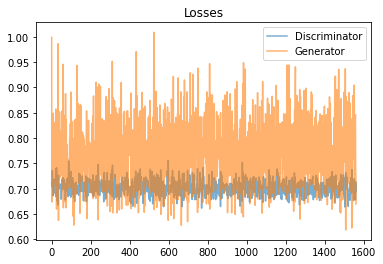

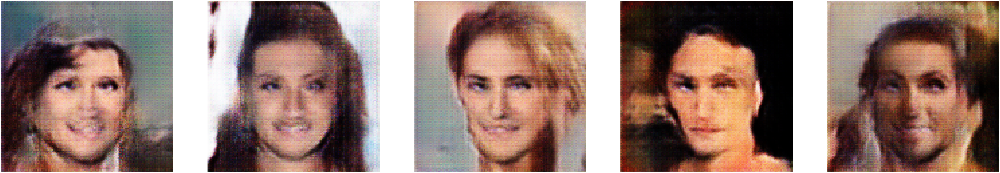

Epoch: 9, iteration: 3124, d_loss: 0.706, g_loss: 0.797, duration: 1.682, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 9/60 
D Loss: 0.69966 
G Loss: 0.77561


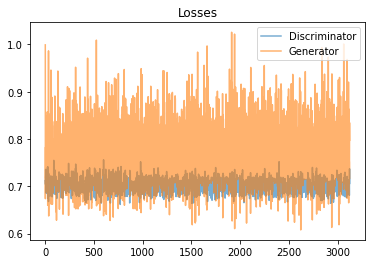

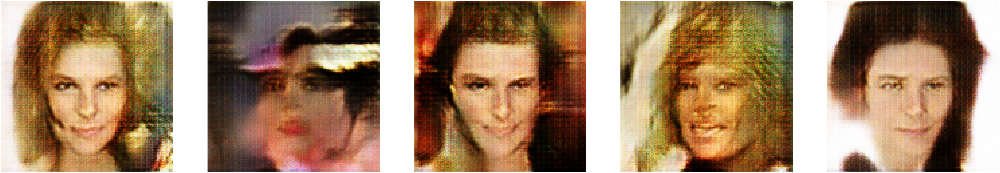

Epoch: 10, iteration: 4263, d_loss: 0.705, g_loss: 0.66, duration: 1.691, minutes remaining: 11.9, remaining files in batch: 27104  

In [ ]:
EPOCH=7
EPOCHS=60
restart_training(EPOCH)

Instructions for updating:
Use keras.layers.Dense instead.
Instructions for updating:
Please use `layer.__call__` method instead.
Instructions for updating:
Use `tf.keras.layers.Conv2DTranspose` instead.
Instructions for updating:
Use keras.layers.BatchNormalization instead.  In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.batch_normalization` documentation).
Instructions for updating:
Use `tf.keras.layers.Conv2D` instead.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
INFO:tensorflow:Restoring parameters from /opt/notebooks/model_9.ckpt
Epoch: 10, iteration: 1562, d_loss: 0.682, g_loss: 0.618, duration: 1.681, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 10/60 
D Loss: 0.70386 
G Loss: 0.70466


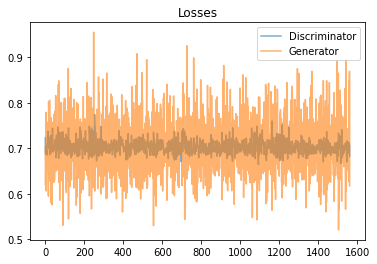

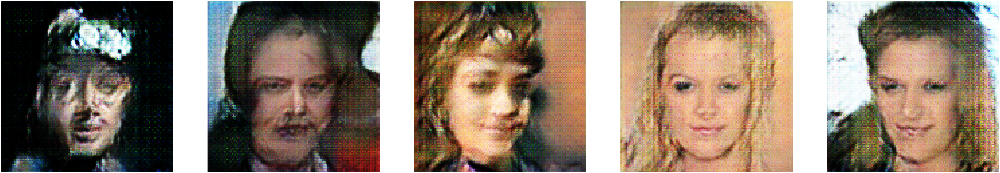

Epoch: 11, iteration: 3124, d_loss: 0.701, g_loss: 0.648, duration: 1.79, minutes remaining: 0.0, remaining files in batch: 32 0    
Epoch 11/60 
D Loss: 0.70247 
G Loss: 0.70549


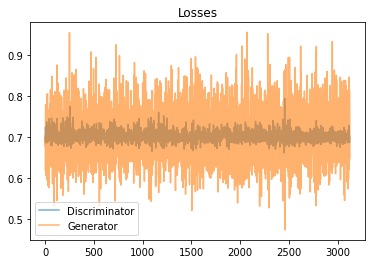

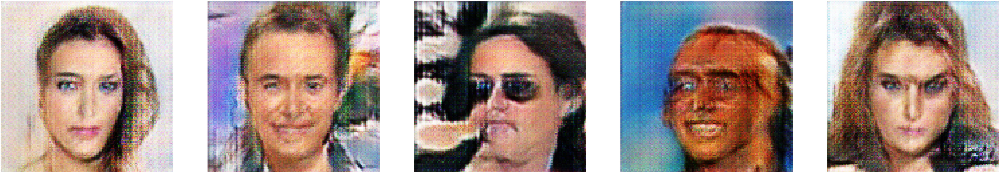

Epoch: 12, iteration: 4686, d_loss: 0.709, g_loss: 0.619, duration: 1.68, minutes remaining: 0.0, remaining files in batch: 32      
Epoch 12/60 
D Loss: 0.70133 
G Loss: 0.70614


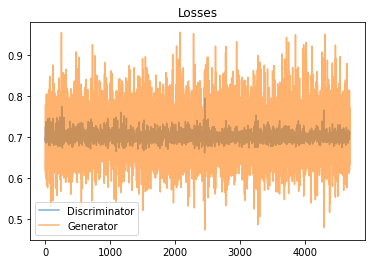

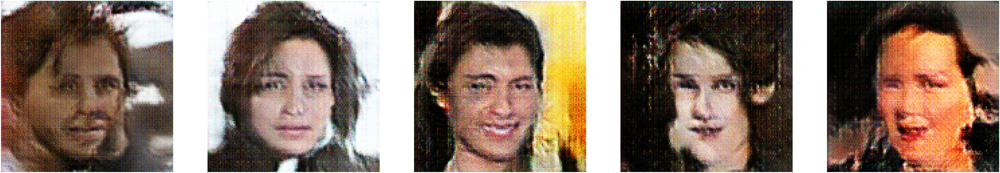

Epoch: 13, iteration: 6248, d_loss: 0.688, g_loss: 0.708, duration: 1.887, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 13/60 
D Loss: 0.70034 
G Loss: 0.70706


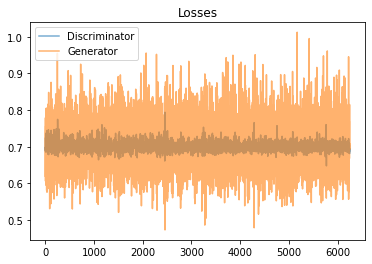

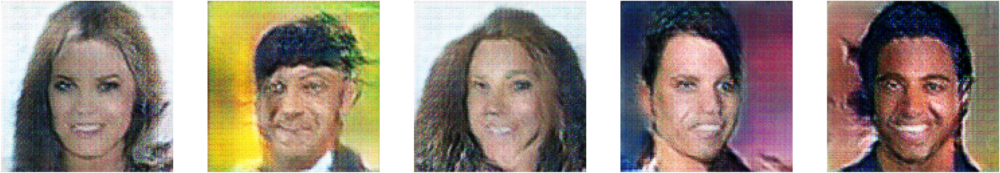

Epoch: 14, iteration: 7810, d_loss: 0.703, g_loss: 0.74, duration: 1.682, minutes remaining: 0.0, remaining files in batch: 32      
Epoch 14/60 
D Loss: 0.69964 
G Loss: 0.70625


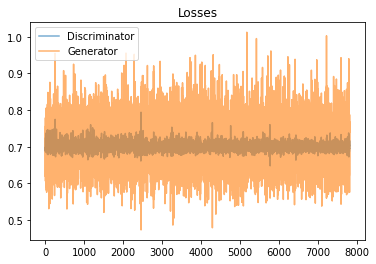

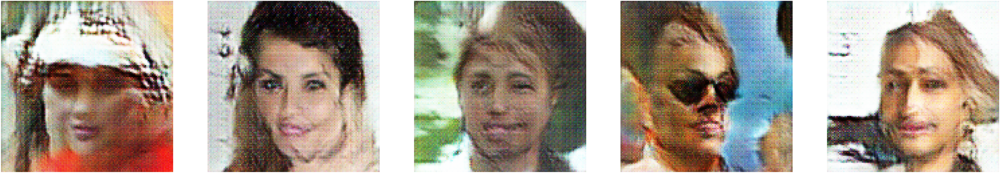

Epoch: 15, iteration: 9372, d_loss: 0.69, g_loss: 0.692, duration: 1.36, minutes remaining: 0.0, remaining files in batch: 32 6     
Epoch 15/60 
D Loss: 0.69939 
G Loss: 0.70589


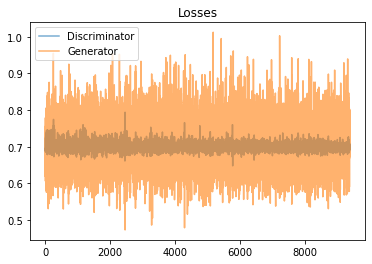

Instructions for updating:
Use standard file APIs to delete files with this prefix.


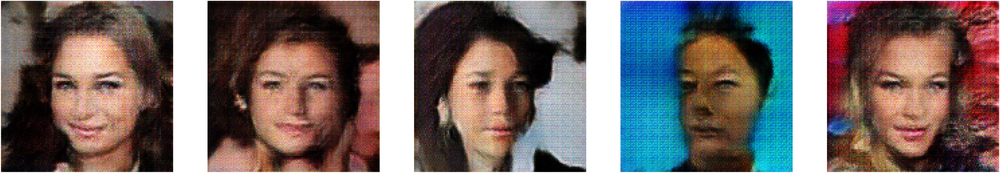

Epoch: 16, iteration: 10934, d_loss: 0.694, g_loss: 0.646, duration: 1.337, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 16/60 
D Loss: 0.69878 
G Loss: 0.70651


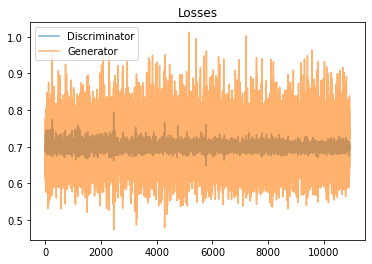

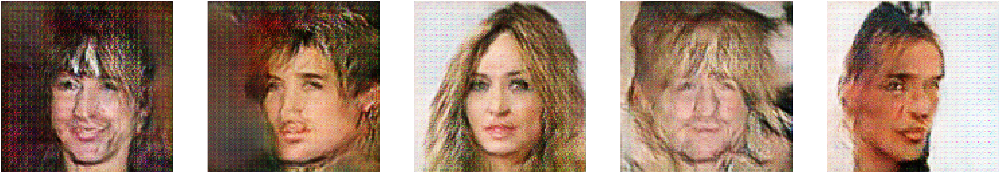

Epoch: 17, iteration: 12496, d_loss: 0.697, g_loss: 0.717, duration: 1.346, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 17/60 
D Loss: 0.69846 
G Loss: 0.70615


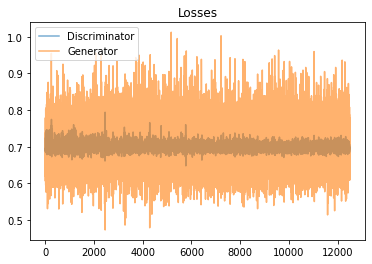

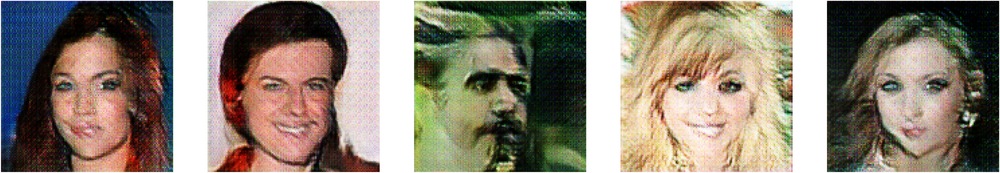

Epoch: 18, iteration: 14058, d_loss: 0.697, g_loss: 0.711, duration: 1.542, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 18/60 
D Loss: 0.69783 
G Loss: 0.70571


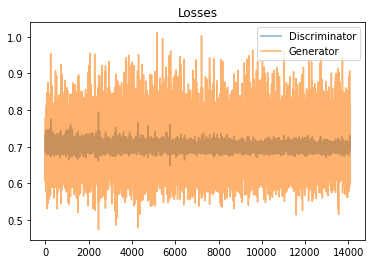

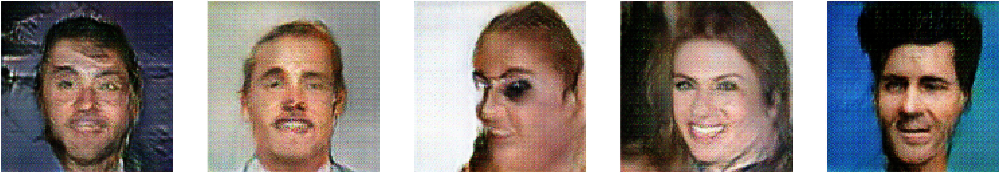

Epoch: 19, iteration: 15620, d_loss: 0.698, g_loss: 0.728, duration: 1.346, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 19/60 
D Loss: 0.69777 
G Loss: 0.70574


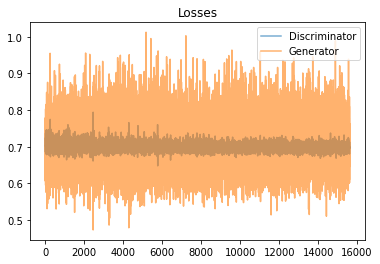

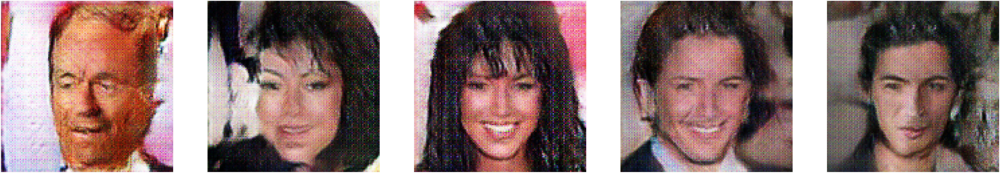

Epoch: 20, iteration: 17182, d_loss: 0.7, g_loss: 0.672, duration: 1.374, minutes remaining: 0.0, remaining files in batch: 32 60    
Epoch 20/60 
D Loss: 0.69752 
G Loss: 0.70556


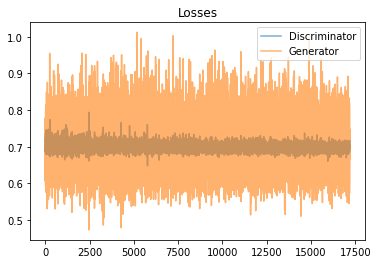

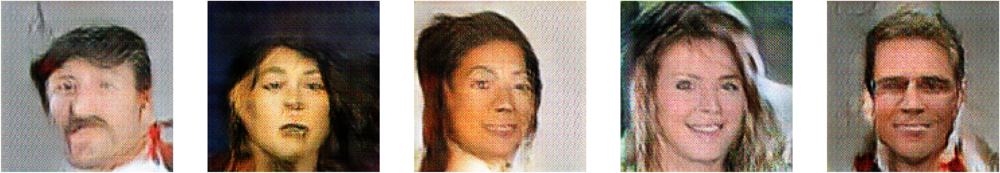

Epoch: 21, iteration: 18744, d_loss: 0.699, g_loss: 0.695, duration: 1.375, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 21/60 
D Loss: 0.69733 
G Loss: 0.70551


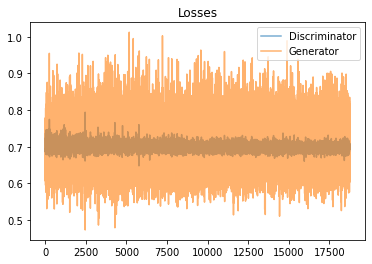

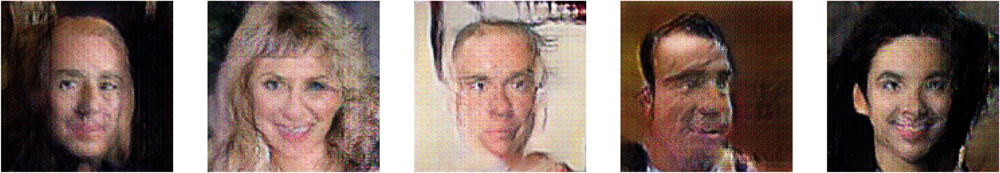

Epoch: 22, iteration: 20306, d_loss: 0.7, g_loss: 0.737, duration: 1.452, minutes remaining: 0.0, remaining files in batch: 32  4    
Epoch 22/60 
D Loss: 0.69715 
G Loss: 0.70442


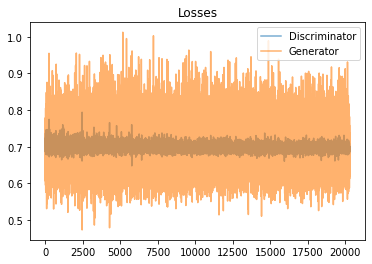

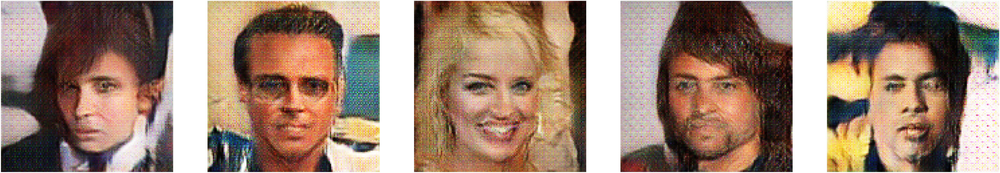

Epoch: 23, iteration: 21868, d_loss: 0.681, g_loss: 0.724, duration: 1.464, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 23/60 
D Loss: 0.69679 
G Loss: 0.70408


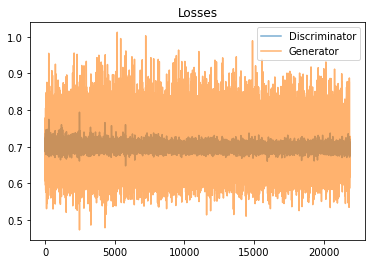

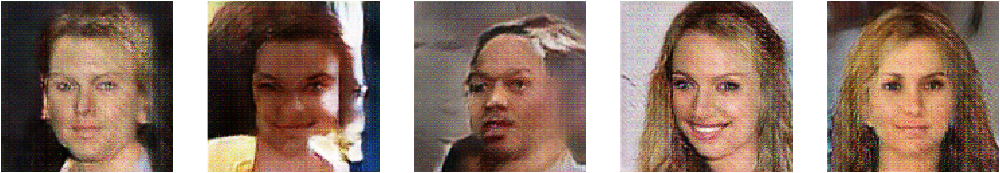

Epoch: 24, iteration: 23430, d_loss: 0.697, g_loss: 0.718, duration: 1.343, minutes remaining: 0.0, remaining files in batch: 32     : 33952 
Epoch 24/60 
D Loss: 0.69643 
G Loss: 0.70304


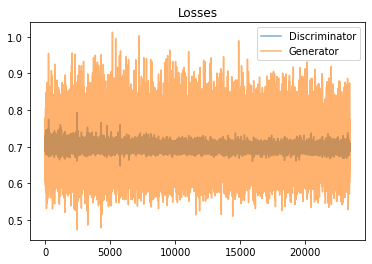

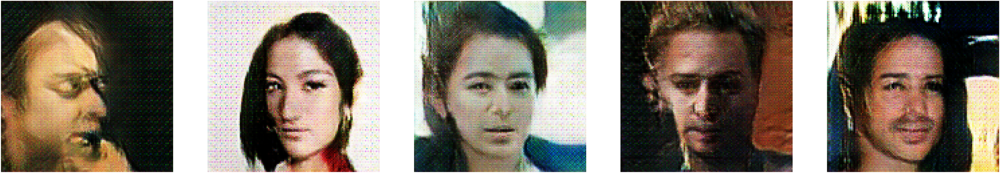

Epoch: 25, iteration: 24992, d_loss: 0.684, g_loss: 0.749, duration: 1.36, minutes remaining: 0.0, remaining files in batch: 32      
Epoch 25/60 
D Loss: 0.69624 
G Loss: 0.70126


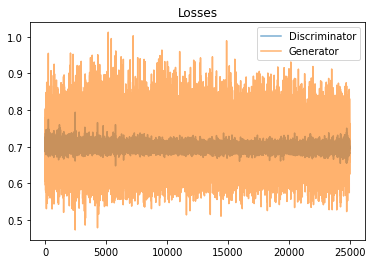

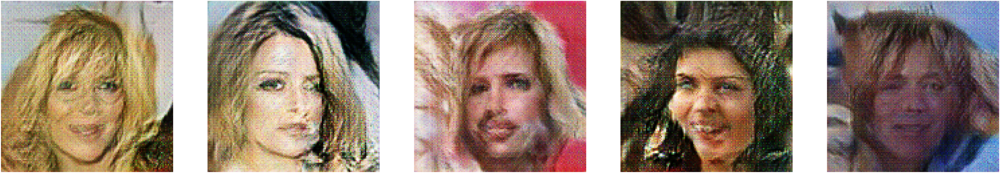

Epoch: 26, iteration: 26554, d_loss: 0.71, g_loss: 0.611, duration: 1.355, minutes remaining: 0.0, remaining files in batch: 32      
Epoch 26/60 
D Loss: 0.69605 
G Loss: 0.69894


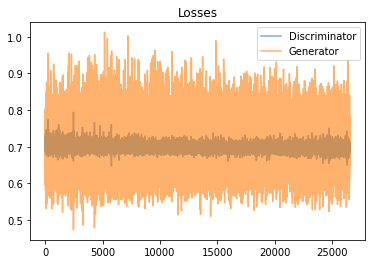

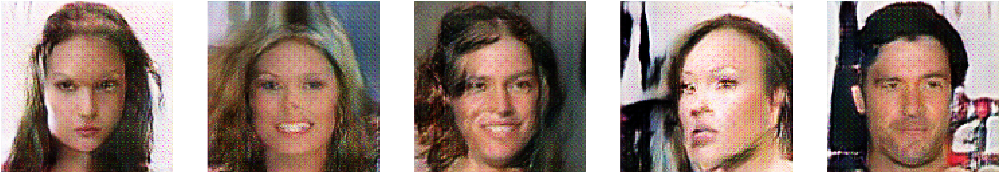

Epoch: 27, iteration: 28116, d_loss: 0.695, g_loss: 0.699, duration: 1.361, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 27/60 
D Loss: 0.69539 
G Loss: 0.69685


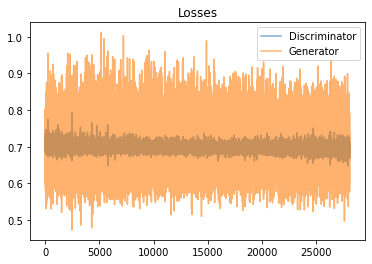

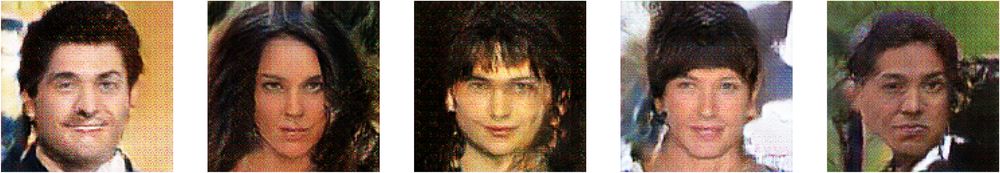

Epoch: 28, iteration: 29678, d_loss: 0.709, g_loss: 0.671, duration: 1.355, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 28/60 
D Loss: 0.69469 
G Loss: 0.69418


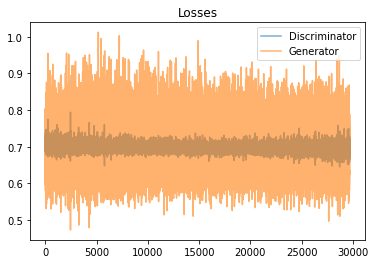

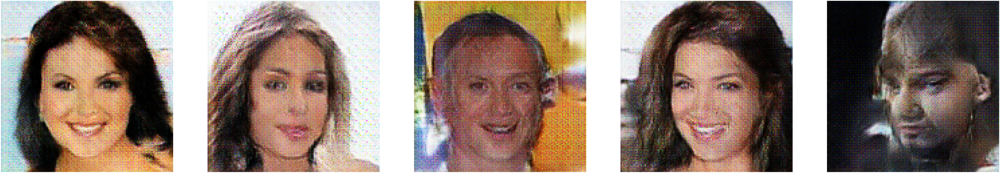

Epoch: 29, iteration: 31240, d_loss: 0.704, g_loss: 0.651, duration: 1.356, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 29/60 
D Loss: 0.69339 
G Loss: 0.69105


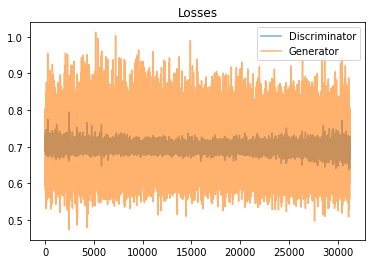

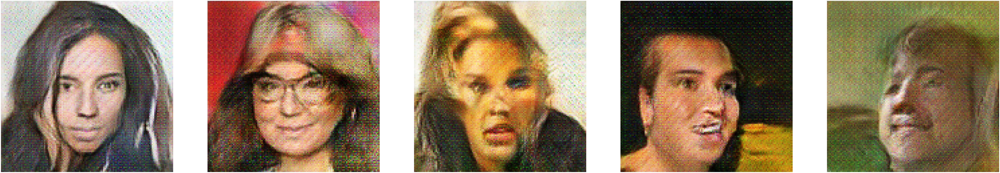

Epoch: 30, iteration: 32802, d_loss: 0.702, g_loss: 0.601, duration: 1.33, minutes remaining: 0.0, remaining files in batch: 32      232 
Epoch 30/60 
D Loss: 0.69198 
G Loss: 0.68606


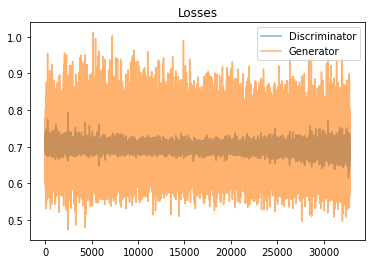

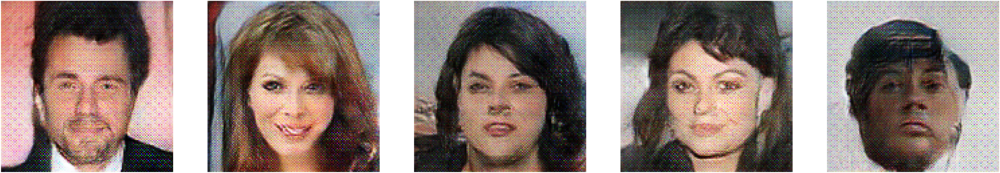

Epoch: 31, iteration: 34364, d_loss: 0.66, g_loss: 0.594, duration: 1.336, minutes remaining: 0.0, remaining files in batch: 32      
Epoch 31/60 
D Loss: 0.68968 
G Loss: 0.68074


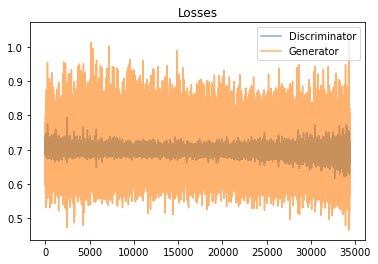

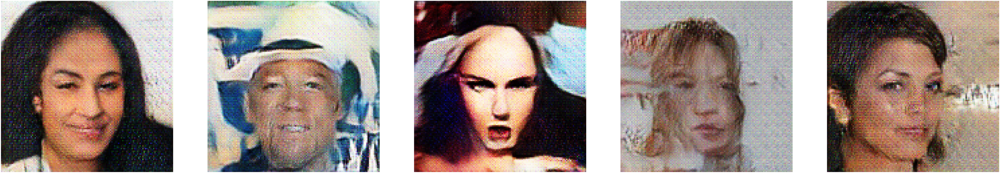

Epoch: 32, iteration: 35926, d_loss: 0.692, g_loss: 0.671, duration: 1.342, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 32/60 
D Loss: 0.68658 
G Loss: 0.67819


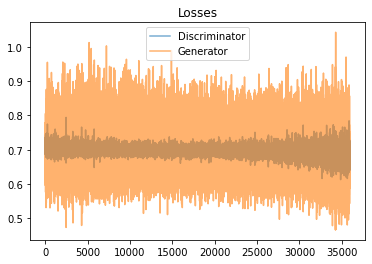

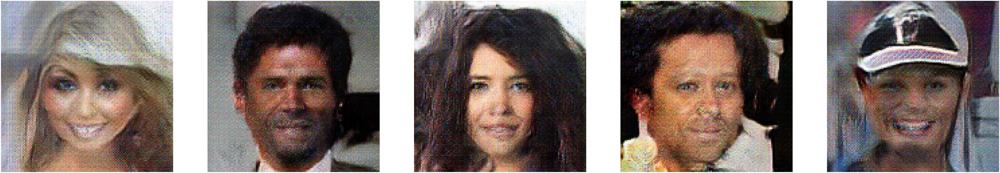

Epoch: 33, iteration: 37488, d_loss: 0.701, g_loss: 0.553, duration: 1.351, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 33/60 
D Loss: 0.68350 
G Loss: 0.67507


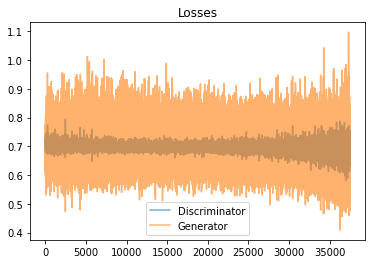

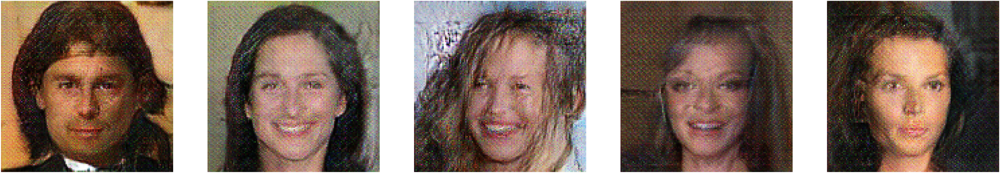

Epoch: 34, iteration: 39050, d_loss: 0.716, g_loss: 0.547, duration: 1.345, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 34/60 
D Loss: 0.68095 
G Loss: 0.66958


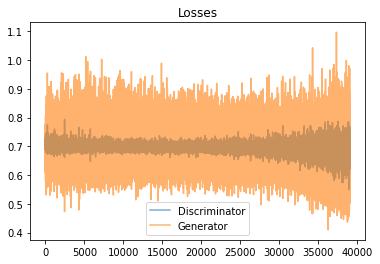

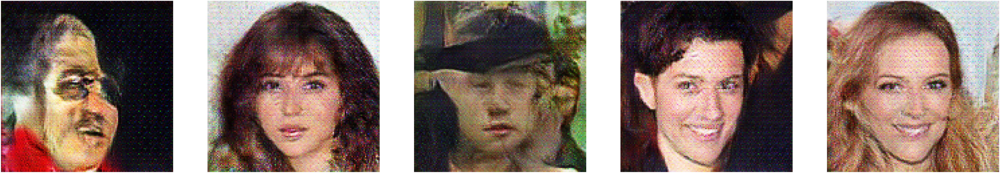

Epoch: 35, iteration: 40612, d_loss: 0.709, g_loss: 0.533, duration: 1.332, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 35/60 
D Loss: 0.67784 
G Loss: 0.66749


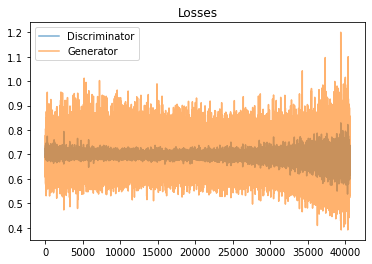

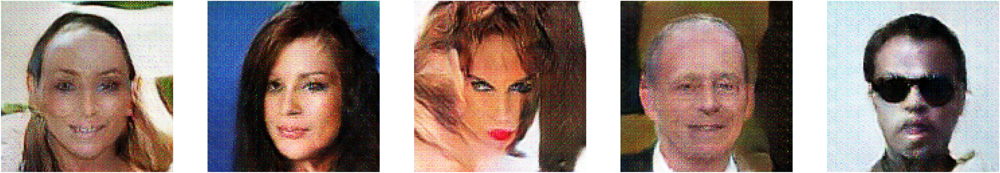

Epoch: 36, iteration: 42174, d_loss: 0.656, g_loss: 0.545, duration: 1.346, minutes remaining: 0.0, remaining files in batch: 32     29920 
Epoch 36/60 
D Loss: 0.67255 
G Loss: 0.66555


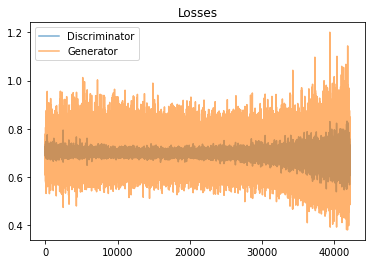

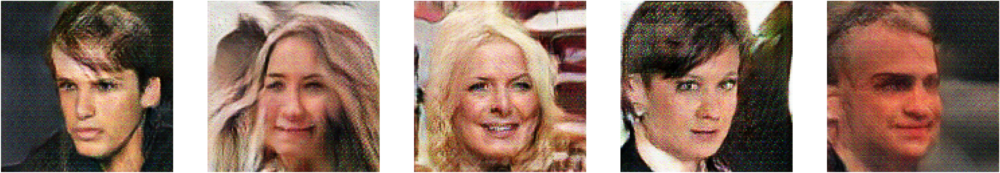

Epoch: 37, iteration: 43736, d_loss: 0.637, g_loss: 0.818, duration: 1.342, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 37/60 
D Loss: 0.66775 
G Loss: 0.66643


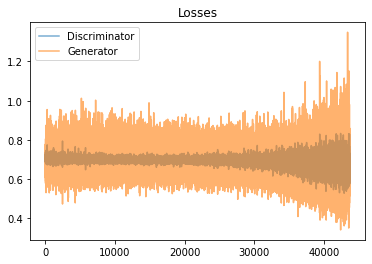

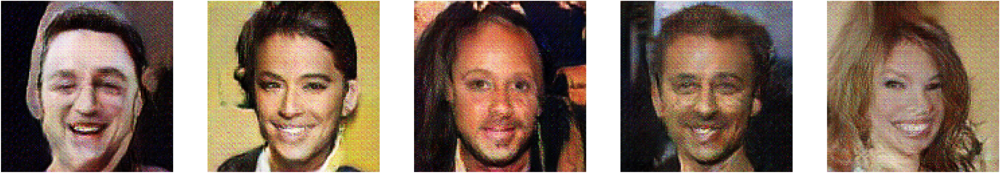

Epoch: 38, iteration: 45298, d_loss: 0.628, g_loss: 0.616, duration: 1.341, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 38/60 
D Loss: 0.66406 
G Loss: 0.66359


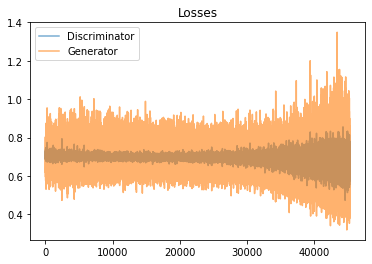

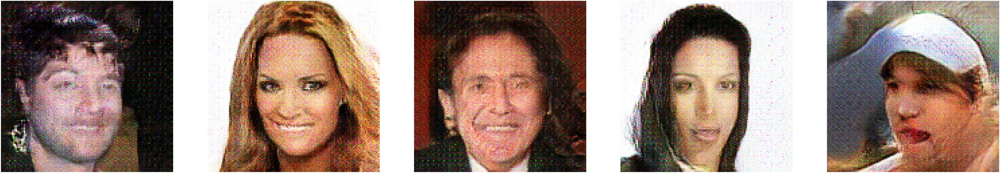

Epoch: 39, iteration: 46860, d_loss: 0.709, g_loss: 0.512, duration: 1.349, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 39/60 
D Loss: 0.65910 
G Loss: 0.66520


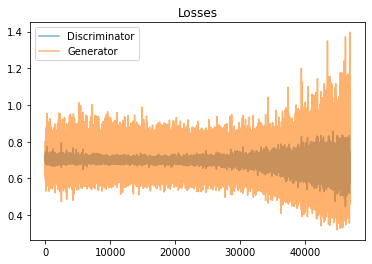

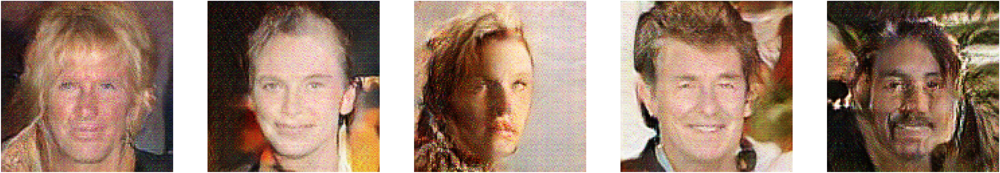

Epoch: 40, iteration: 48422, d_loss: 0.764, g_loss: 0.447, duration: 1.345, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 40/60 
D Loss: 0.65415 
G Loss: 0.66602


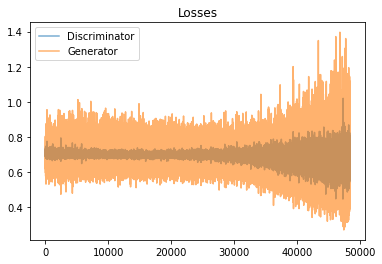

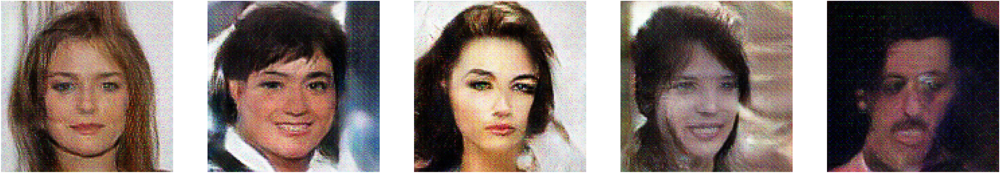

Epoch: 41, iteration: 49984, d_loss: 0.663, g_loss: 0.672, duration: 1.338, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 41/60 
D Loss: 0.64988 
G Loss: 0.66907


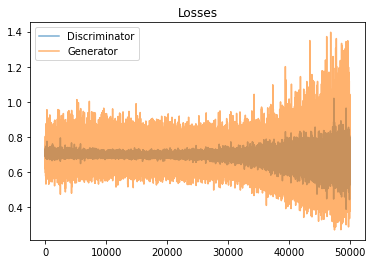

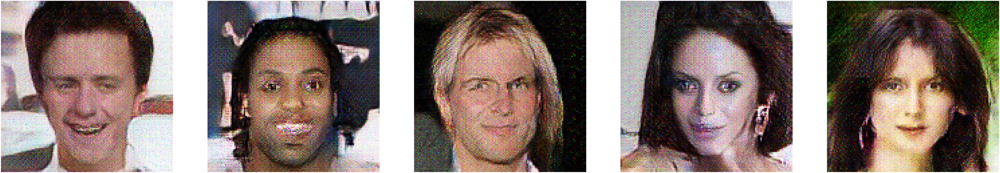

Epoch: 42, iteration: 51546, d_loss: 0.677, g_loss: 1.138, duration: 1.327, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 42/60 
D Loss: 0.64395 
G Loss: 0.67039


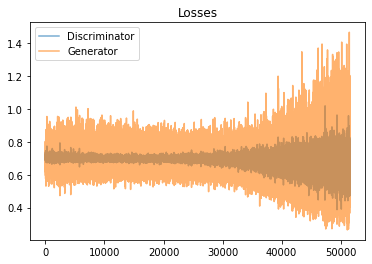

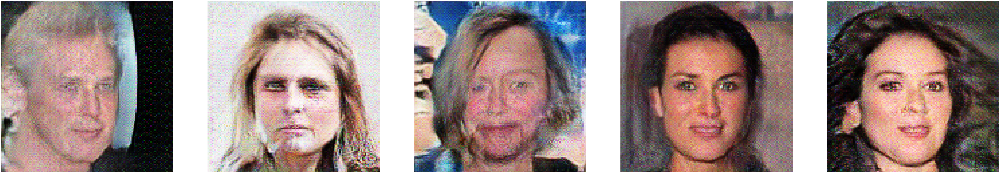

Epoch: 43, iteration: 53108, d_loss: 0.613, g_loss: 0.798, duration: 1.356, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 43/60 
D Loss: 0.63841 
G Loss: 0.67901


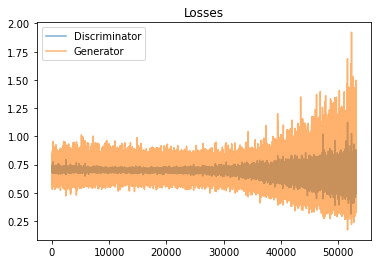

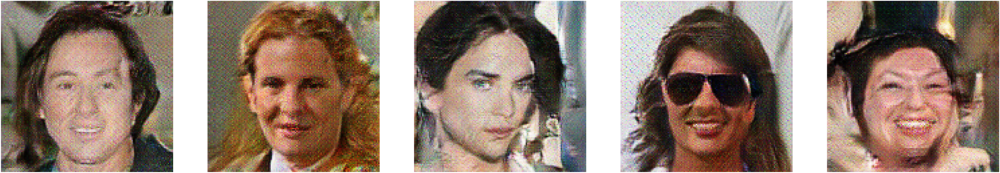

Epoch: 44, iteration: 54670, d_loss: 0.599, g_loss: 0.86, duration: 1.327, minutes remaining: 0.0, remaining files in batch: 32      
Epoch 44/60 
D Loss: 0.63358 
G Loss: 0.68086


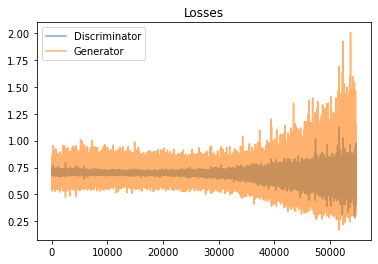

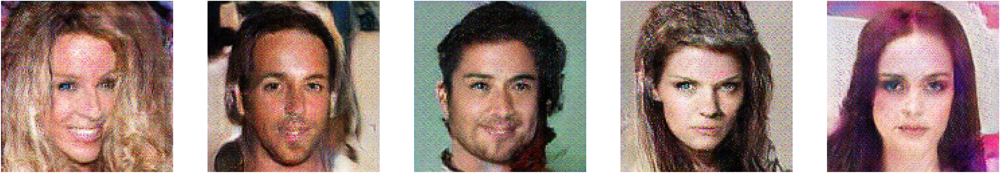

Epoch: 45, iteration: 56232, d_loss: 0.513, g_loss: 0.898, duration: 1.346, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 45/60 
D Loss: 0.62806 
G Loss: 0.68825


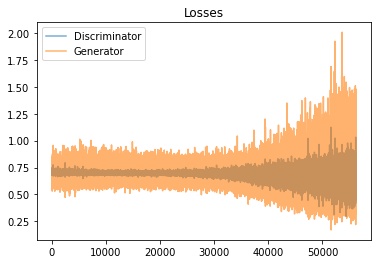

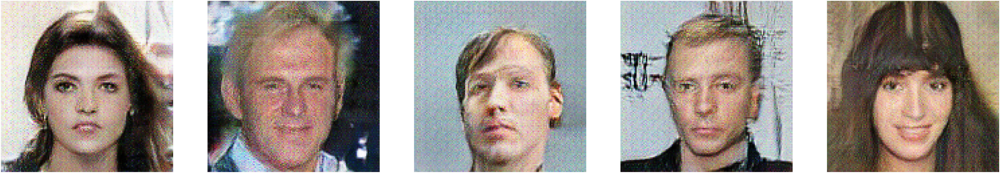

Epoch: 46, iteration: 57794, d_loss: 0.826, g_loss: 0.3, duration: 1.34, minutes remaining: 0.0, remaining files in batch: 32 96     
Epoch 46/60 
D Loss: 0.62444 
G Loss: 0.69242


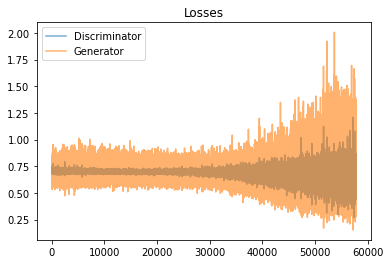

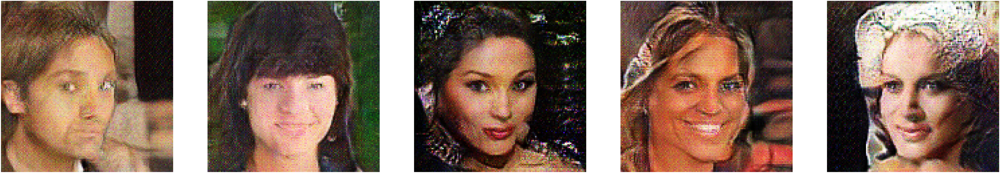

Epoch: 47, iteration: 59356, d_loss: 0.486, g_loss: 0.824, duration: 1.376, minutes remaining: 0.0, remaining files in batch: 32     : 75040 
Epoch 47/60 
D Loss: 0.62215 
G Loss: 0.69394


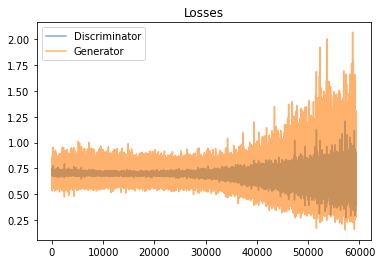

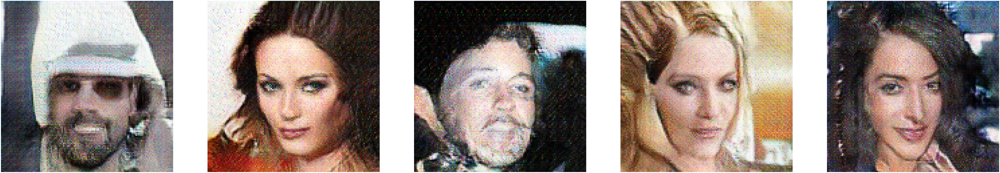

Epoch: 48, iteration: 60918, d_loss: 0.661, g_loss: 0.485, duration: 1.343, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 48/60 
D Loss: 0.61820 
G Loss: 0.69986


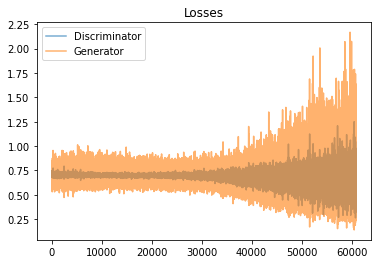

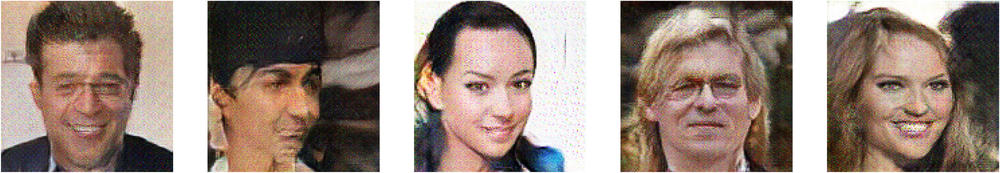

Epoch: 49, iteration: 62480, d_loss: 0.469, g_loss: 1.469, duration: 1.344, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 49/60 
D Loss: 0.61389 
G Loss: 0.70654


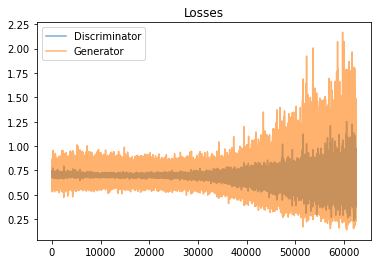

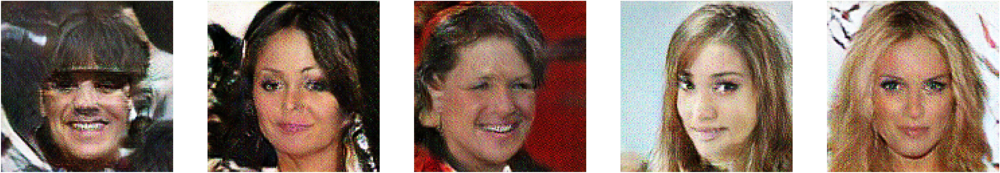

Epoch: 50, iteration: 64042, d_loss: 0.57, g_loss: 0.594, duration: 1.349, minutes remaining: 0.0, remaining files in batch: 32 0    
Epoch 50/60 
D Loss: 0.60665 
G Loss: 0.71535


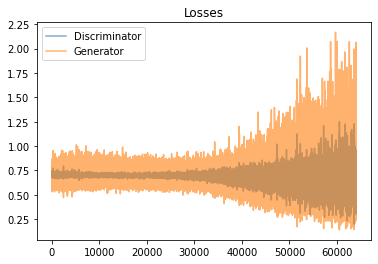

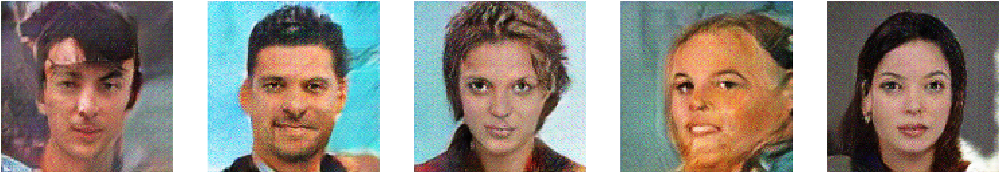

Epoch: 51, iteration: 65604, d_loss: 0.698, g_loss: 0.481, duration: 1.36, minutes remaining: 0.0, remaining files in batch: 32 0    
Epoch 51/60 
D Loss: 0.60383 
G Loss: 0.72476


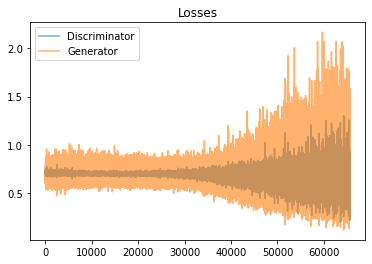

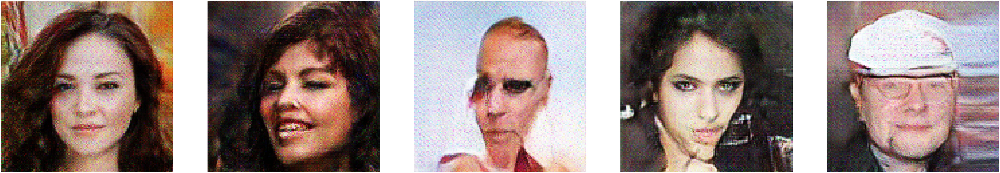

Epoch: 52, iteration: 67166, d_loss: 0.603, g_loss: 0.558, duration: 1.335, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 52/60 
D Loss: 0.60031 
G Loss: 0.73675


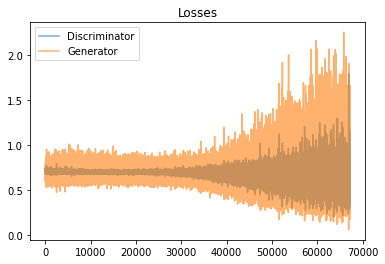

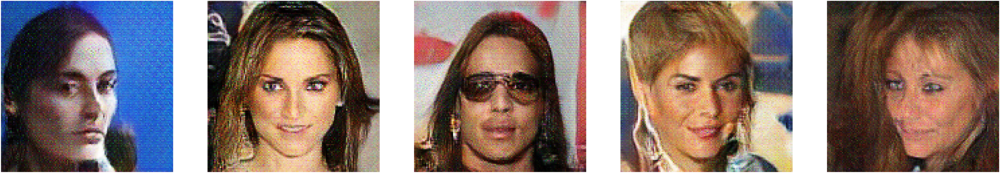

Epoch: 53, iteration: 68728, d_loss: 0.329, g_loss: 1.114, duration: 1.331, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 53/60 
D Loss: 0.59624 
G Loss: 0.74201


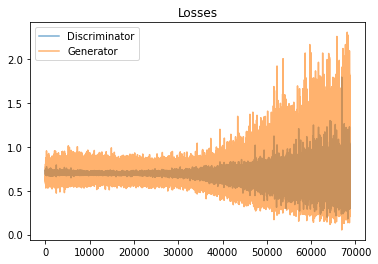

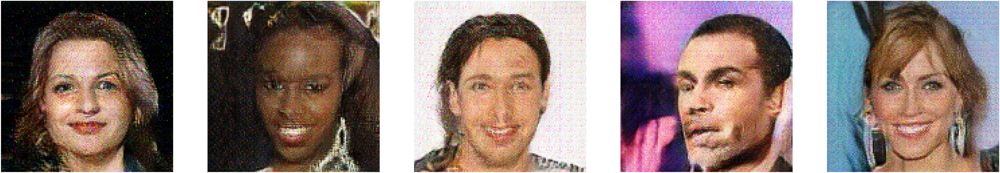

Epoch: 54, iteration: 70290, d_loss: 0.414, g_loss: 1.54, duration: 1.336, minutes remaining: 0.0, remaining files in batch: 32      
Epoch 54/60 
D Loss: 0.58921 
G Loss: 0.75236


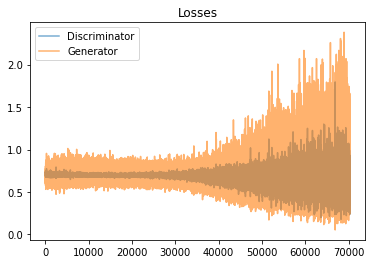

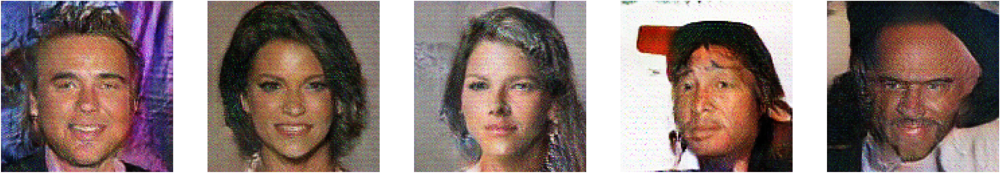

Epoch: 55, iteration: 71852, d_loss: 0.541, g_loss: 0.651, duration: 1.357, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 55/60 
D Loss: 0.58723 
G Loss: 0.76941


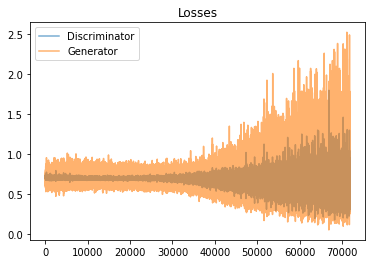

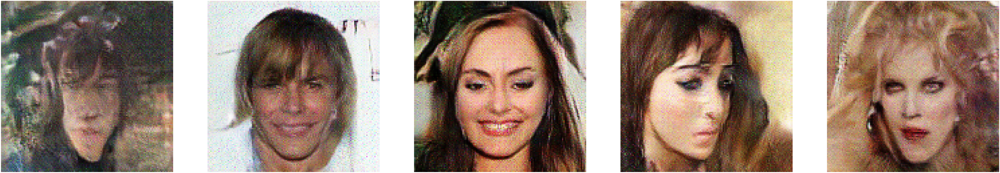

Epoch: 56, iteration: 73414, d_loss: 0.623, g_loss: 0.553, duration: 1.336, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 56/60 
D Loss: 0.58835 
G Loss: 0.77200


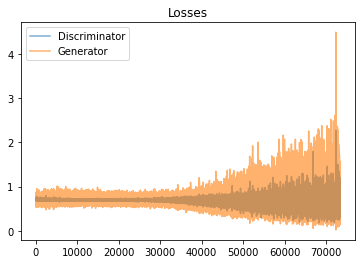

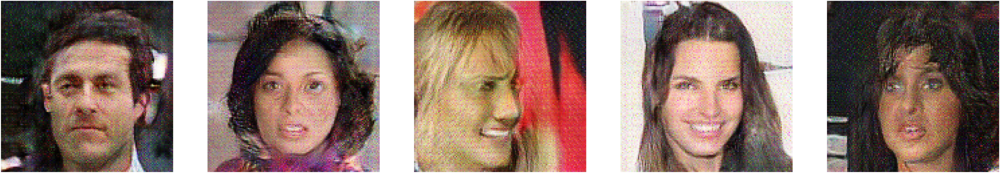

Epoch: 57, iteration: 74976, d_loss: 0.486, g_loss: 0.759, duration: 1.387, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 57/60 
D Loss: 0.58306 
G Loss: 0.78333


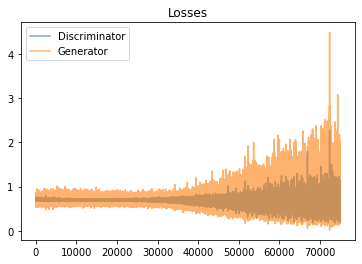

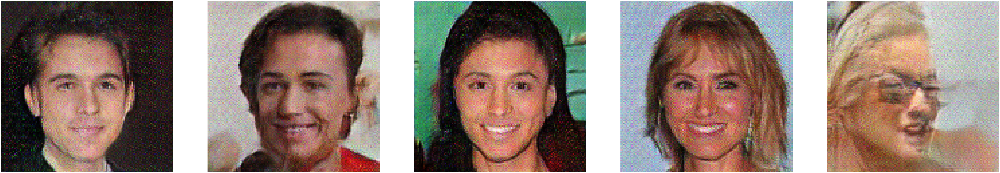

Epoch: 58, iteration: 76538, d_loss: 0.554, g_loss: 0.654, duration: 1.326, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 58/60 
D Loss: 0.57678 
G Loss: 0.79181


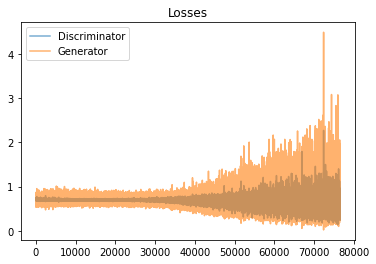

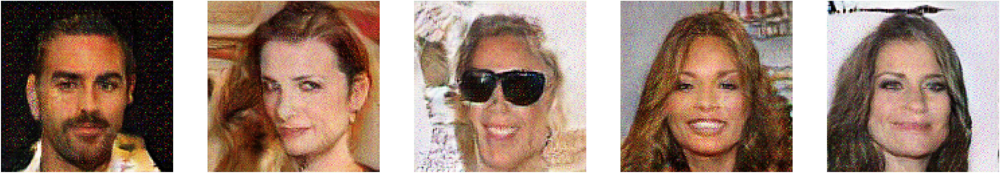

Epoch: 59, iteration: 78100, d_loss: 0.487, g_loss: 0.752, duration: 1.338, minutes remaining: 0.0, remaining files in batch: 32     
Epoch 59/60 
D Loss: 0.58233 
G Loss: 0.78590


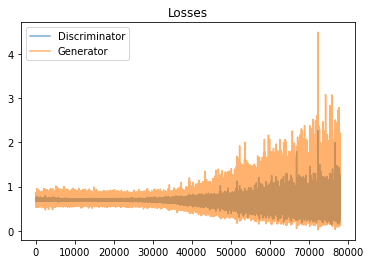

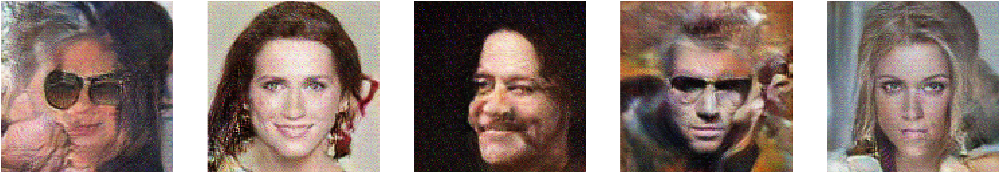

Epoch: 60, iteration: 79662, d_loss: 0.779, g_loss: 0.39, duration: 1.397, minutes remaining: 0.0, remaining files in batch: 32      
Epoch 60/60 
D Loss: 0.57842 
G Loss: 0.80148


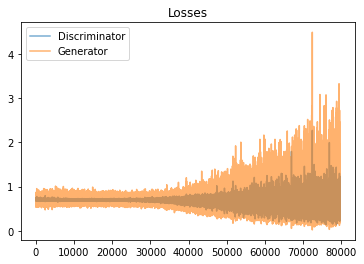

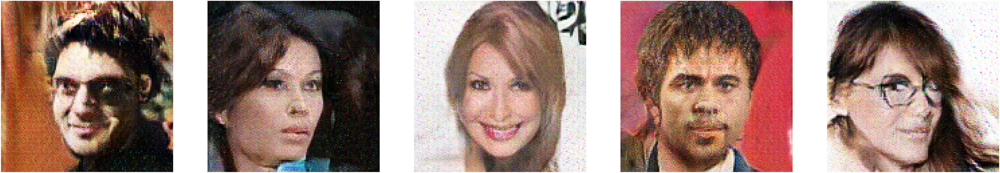

In [16]:
EPOCH=9
EPOCHS=60
restart_training(EPOCH)